# Import packages

In [1]:
!hostname

nia0178.scinet.local


In [1]:
import anndata
import src.helper_functions as src
import multiprocessing as mp
import pandas as pd
from importlib import reload
import numpy as np
from matplotlib import pyplot as plt
from functools import partial
import plotly.express as px
from itertools import product
import seaborn as sns

# Preprocessing

In [ ]:
%cd /scratch/s/shreejoy/nxu/CIHR
adata = anndata.read_h5ad("proc/adata.h5ad")

/gpfs/fs0/scratch/s/shreejoy/nxu/CIHR


In [ ]:
adata_filtered = anndata.read_h5ad("proc/adata_filtered.h5ad")
intron_group_size = adata_filtered.var.groupby("intron_group").size()
intron_group_size.name = "intron_group_size"
adata_filtered.var = pd.merge(adata_filtered.var, intron_group_size, left_on="intron_group", right_index=True, how="left")
adata_filtered.var = adata_filtered.var.rename(columns={"intron_group_size_y": "intron_group_size"}).drop(columns="intron_group_size_x")

/tmp/ipykernel_2291/1116229973.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  intron_group_size = adata_filtered.var.groupby("intron_group").size()


# Benchmarking

In [12]:
%%capture
# adata = anndata.read_h5ad("proc/adata.h5ad")
n_cores = 80

min_global_SJ_counts = [10, 50, 200, 500, 1000]
min_cells_per_feature = [10, 20, 50, 100, 200]

get_sum_stats_sc_partial = partial(src.get_sum_stats_sc, adata)

iterable = [(a, b) for a, b in product(min_global_SJ_counts, min_cells_per_feature)]

if len(iterable) < n_cores:
    chunksize = 1
else:
    chunksize = len(iterable)//n_cores

with mp.Pool(processes=n_cores) as p:
    df = p.imap_unordered(get_sum_stats_sc_partial, iterable, chunksize=chunksize)
    df = pd.DataFrame(df)
    df.to_csv("proc/sum_stats_sc.csv")        
    p.close()    


# Plotting

## Total count per splice junction

Text(0, 0.5, 'Proportion')

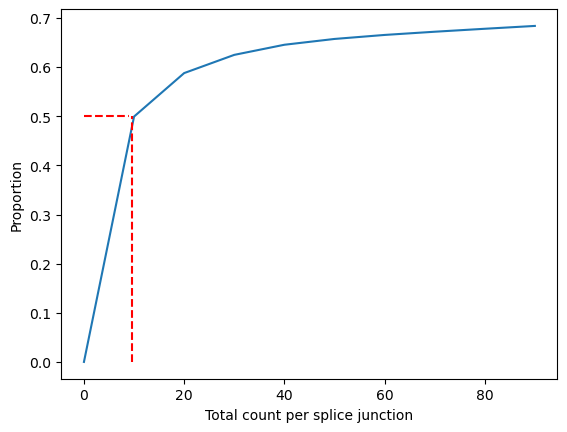

In [4]:
sum_stats_sc = pd.read_csv("proc/sum_stats_sc.csv", index_col=0)
total_count_per_intron = np.array(adata.X.sum(axis=0))
max = 100
plt.plot(range(0, max, 10), [np.where(total_count_per_intron < i)[1].shape[0]/total_count_per_intron.shape[1] for i in range(0, max, 10)])
plt.hlines(0.5, 0, 9, colors="red", linestyles="dashed")
plt.vlines(9.5, 0, 0.5, colors="red", linestyles="dashed")
plt.xlabel("Total count per splice junction")
plt.ylabel("Proportion")

In [37]:
intron_sum = adata.var["unique"].to_numpy()
n_cell_per_feature = np.count_nonzero(adata.X.toarray(), axis=0)
df = pd.DataFrame({"intron_sum": intron_sum, "n_cell_per_feature": n_cell_per_feature})
df.index= adata.var.intron
df = df.reset_index()
# plt.plot(intron_sum, n_cell_per_feature, "o", markersize=1, alpha=0.5)
# plt.hlines(1500, 0, 1.6e6, colors="red", linestyles="dashed")
# plt.vlines(0.4e6, 0, 4000, colors="red", linestyles="dashed")
# plt.xlabel("Sum of introns across cells")
# plt.ylabel("Number of cells per intron")

## n_cell_per_feature vs. intron_sum

In [36]:
px.scatter(df, x="intron_sum", y="n_cell_per_feature", hover_name="intron", width=800, height=700)

## Filtering criteria benchmark

In [15]:
sum_stats_sc = sum_stats_sc.assign(percent_explored = sum_stats_sc["n_intron_final"]/sum_stats_sc["n_intron_after_min_global_SJ"])

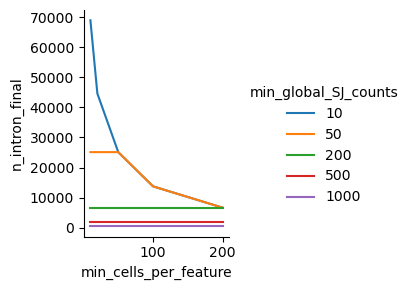

In [14]:
g = sns.FacetGrid(sum_stats_sc, hue="min_global_SJ_counts", margin_titles=True, palette="tab10")
g.map(sns.lineplot, "min_cells_per_feature", "n_intron_final")
g.add_legend()

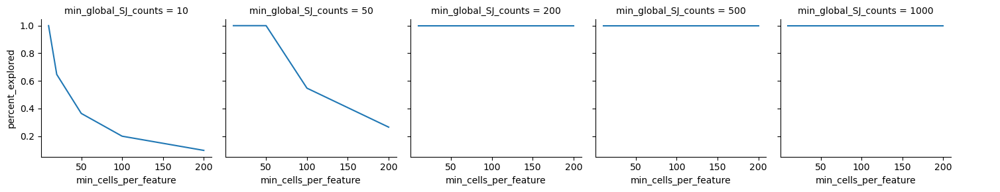

In [17]:
g = sns.FacetGrid(sum_stats_sc, col="min_global_SJ_counts", margin_titles=True, palette="tab10")
g.map(sns.lineplot, "min_cells_per_feature", "percent_explored")
g.add_legend()

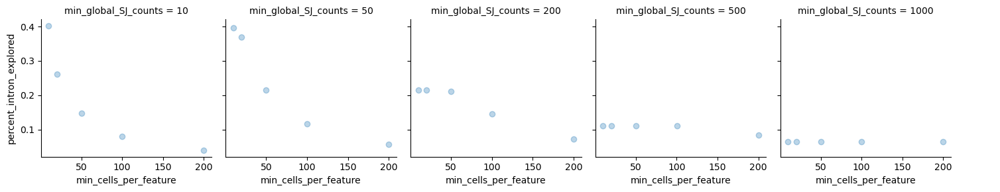

In [124]:
g = sns.FacetGrid(sum_stats_sc, col="min_global_SJ_counts", margin_titles=True, palette="tab10")
g.map(sns.regplot, "min_cells_per_feature", "percent_intron_explored", fit_reg=False, x_jitter=.1, scatter_kws={"alpha": 0.3})
g.add_legend()

## Proportion of cells with n distinct splice sites

In [100]:
def get_intron_size_proportion(adata_filtered, n):
    temp_arr = adata_filtered[:, adata_filtered.var.intron_group_size == n].X.toarray()
    arr_list = np.split(temp_arr, temp_arr.shape[1]/n, axis=1)
    temp_df = pd.DataFrame([[(np.count_nonzero(X, axis=1) == i).sum() / X.shape[0] for i in range(X.shape[1]+1)] for X in arr_list])
    return temp_df

In [ ]:
i = 4
pie_df = adata_filtered.var.groupby("intron_group").size().value_counts()
pie_df = pd.DataFrame(pie_df).reset_index()
pie_df = pd.concat([pie_df[:i], pd.DataFrame({"index":6, "count":pie_df.loc[pie_df["index"] >= i, "count"].sum()}, index=[i])], axis=0)
# pie_df.sort_values("index", inplace=True, ascending=False)
colors = ["Greens", "Blues", "Reds", "Purples"]
bar_colors = [sns.color_palette(color, 1)[0] for color in colors]+sns.color_palette("Greys", 1)

/tmp/ipykernel_2291/2629806097.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  pie_df = adata_filtered.var.groupby("intron_group").size().value_counts()


Text(0.55, -0.03, 'Proportion of cells with n distinct splice sites')

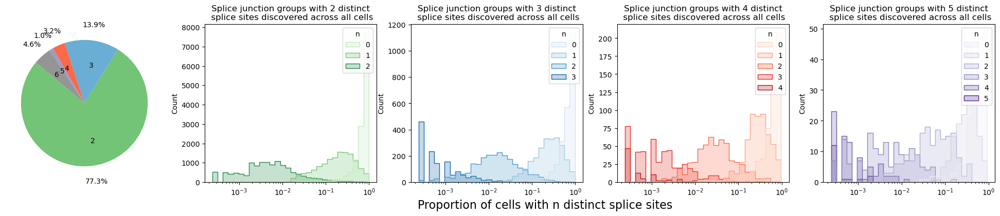

In [251]:
n_intron_group_sizes = [2, 3, 4, 5]
fig, ax = plt.subplots(1, len(n_intron_group_sizes)+1, figsize=(25, 4))
ax[0].pie(pie_df["count"], labels=pie_df["index"], startangle=140, colors=bar_colors, autopct='%1.1f%%', pctdistance=1.25, labeldistance=.6)
for i, n, color in zip(range(1, 5), n_intron_group_sizes, colors):
    get_intron_size_proportion(adata_filtered, n)\
        .melt(var_name="n")\
        .pipe(sns.histplot, x="value", hue="n", element="step", 
              common_norm=False, bins=30, ax = ax[i], log_scale = True, palette=sns.color_palette(color, n+1))
    ax[i].set_xlabel("")
    ax[i].set_title(f"Splice junction groups with {n} distinct\n splice sites discovered across all cells") 
fig.supxlabel('Proportion of cells with n distinct splice sites', ha='center', fontsize=16, y=-0.03, x = 0.55)

## Sum stats

In [6]:
df = pd.read_csv("proc/sum_stats_sc.csv", index_col = 0)

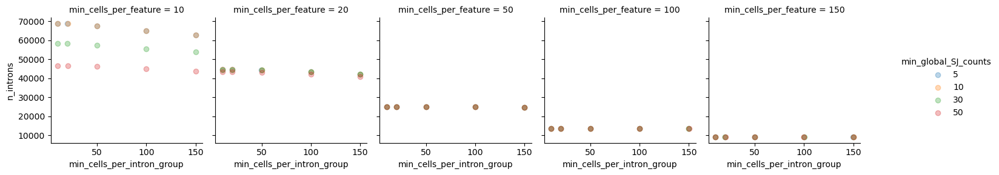

In [8]:
g = sns.FacetGrid(df, hue="min_global_SJ_counts", col="min_cells_per_feature", margin_titles=True, palette="tab10")
g.map(sns.regplot, "min_cells_per_intron_group", "n_introns", fit_reg=False, x_jitter=.1, scatter_kws={"alpha": 0.3})
g.add_legend()